<a href="https://colab.research.google.com/github/mariananlemos/DeepLearning_TensorFlow/blob/main/Projeto_14_Deep_dream.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Projeto 14: Deep Dream

Codificação adaptada da documentação do TensorFlow: https://www.tensorflow.org/beta/tutorials/generative/deepdream
 

# Etapa 1: Importação das bibliotecas

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random
tf.__version__

TensorFlow 2.x selected.


'2.1.0-rc1'

# Etapa 2: Importação do modelo com pesos pré-treinados

In [ ]:
base_model = tf.keras.applications.InceptionV3(include_top = False,
                                              weights = 'imagenet')

In [ ]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
_______________________________________________________________________________________

# Nota:
- O objetivo do algoritmo é selecionar uma camada para maximizar a loss function, que são as ativações
- Podemos selecionar qualquer camada, lembrando que as primeiras camadas possuem características mais simples (bordas) e camadas superiores possuem características mais complexas e detalhadas dos objetos
- A rede Inception possui múltiplas camadas concatenadas chamadas de 'mixed' 

In [ ]:
# names = ['mixed8', 'mixed9']
#names = ['mixed3', 'mixed5', 'mixed8', 'mixed9']
names = ['mixed3', 'mixed5']
# names = ['mixed5']

In [ ]:
layers = [base_model.get_layer(name).output for name in names]

In [ ]:
layers

[<tf.Tensor 'mixed3/Identity:0' shape=(None, None, None, 768) dtype=float32>,
 <tf.Tensor 'mixed5/Identity:0' shape=(None, None, None, 768) dtype=float32>]

In [ ]:
deepdream_model = tf.keras.Model(inputs = base_model.input, outputs = layers)

# Etapa 3: Processar uma imagem

In [ ]:
sample_image = tf.keras.preprocessing.image.load_img(r'/content/StaryNight.jpg',
                                                     target_size = (225, 375))

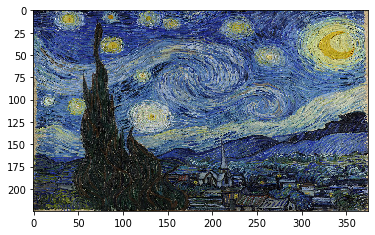

In [ ]:
plt.imshow(sample_image)

In [ ]:
type(sample_image)

PIL.Image.Image

In [ ]:
sample_image = np.array(sample_image) / 255.0
sample_image.shape

(225, 375, 3)

In [ ]:
type(sample_image)

numpy.ndarray

In [ ]:
sample_image.max()

1.0

In [ ]:
sample_image.min()

0.0

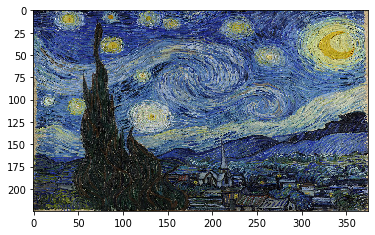

In [ ]:
plt.imshow(sample_image)

# Etapa 4: Executar o modelo pré-treinado e explorar as ativações

In [ ]:
sample_image = tf.keras.preprocessing.image.img_to_array(sample_image)
sample_image.shape

(225, 375, 3)

In [ ]:
type(sample_image)

numpy.ndarray

In [ ]:
sample_image = tf.Variable(tf.keras.applications.inception_v3.preprocess_input(sample_image))

In [ ]:
type(sample_image)

tensorflow.python.ops.resource_variable_ops.ResourceVariable

In [ ]:
sample_image = tf.expand_dims(sample_image, axis = 0)
np.shape(sample_image)

TensorShape([1, 225, 375, 3])

In [ ]:
sample_image.shape

TensorShape([1, 225, 375, 3])

In [ ]:
activations = deepdream_model(sample_image)

In [ ]:
len(activations)

2

In [ ]:
activations[1]

<tf.Tensor: shape=(1, 12, 21, 768), dtype=float32, numpy=
array([[[[3.3623037 , 4.190623  , 3.9559448 , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 3.291566  , ..., 0.        ,
          0.        , 0.        ],
         [1.193265  , 2.8545077 , 0.96760666, ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.04281037, 1.3122522 , 1.0145415 , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 2.0416923 , ..., 0.        ,
          0.        , 0.04361733],
         [1.5414263 , 1.8796766 , 1.8178892 , ..., 0.        ,
          0.        , 0.19873492]],

        [[1.1934961 , 2.1502764 , 2.3389978 , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 4.6458354 , ..., 0.        ,
          0.        , 0.        ],
         [0.21733464, 1.6891705 , 0.23644185, ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.452390

# Etapa 5: Cálculo da loss

- Calcularemos a loss que representa o somatório das ativações de uma camada específica
- Na maioria das vezes o objetivo é minizar o erro (loss) usando a descida gradiente, porém, em deep dream o objetivo é maximizar a loss 
- Isso é feito usando subida do gradiente (gradient ascent)
- A função encaminha a imagem pela rede neural e gera as ativações. Depois obtemos a soma das saídas
 

In [ ]:
def calc_loss(image, model, test = 1):
  if test == 1:
    img_batch = tf.expand_dims(image, axis = 0)
    layer_activations = model(img_batch)
  else:
    layer_activations = model(image)

  losses = []
  for act in layer_activations:
    loss = tf.math.reduce_mean(act)
    losses.append(loss)

  print('Losses from multiple activation layers = ', losses)
  print('Losses shape = ', np.shape(losses))
  print('Sum of all losses = ', tf.reduce_sum(losses))

  return tf.reduce_sum(losses)

In [ ]:
loss = calc_loss(sample_image, deepdream_model, test = 0)
loss

Losses from multiple activation layers =  [<tf.Tensor: shape=(), dtype=float32, numpy=0.2634555>, <tf.Tensor: shape=(), dtype=float32, numpy=0.17727213>]
Losses shape =  (2,)
Sum of all losses =  tf.Tensor(0.44072765, shape=(), dtype=float32)


<tf.Tensor: shape=(), dtype=float32, numpy=0.44072765>

# Etapa 6: Subida do gradiente

- Vamos utilizar a loss calculada no passo anterior e calcular o gradiente com respeito a imagem de entrada. Depois adicionamos os valores na imagem de entrada


In [ ]:
@tf.function
def deepdream(model, image, step_size):
  with tf.GradientTape() as tape:
    tape.watch(image)
    loss = calc_loss(image, model)

  gradients = tape.gradient(loss, image)
  gradients /= tf.math.reduce_std(gradients)
  image = image + gradients * step_size
  image = tf.clip_by_value(image, -1, 1)

  return loss, image

In [ ]:
def run_deep_dream_simple(model, image, steps = 100, step_size = 0.01):
  image = tf.keras.applications.inception_v3.preprocess_input(image)
  for step in range(steps):
    loss, image = deepdream(model, image, step_size)

    if step % 100 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print('Step {}, loss {}'.format(step, loss))
  
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

In [ ]:
def deprocess(image):
  image = 255 * (image + 1.0) / 2.0
  return tf.cast(image, tf.uint8)

# Etapa 7: Primeiro teste

In [ ]:
test_image = tf.keras.preprocessing.image.load_img(r'/content/StaryNight.jpg',
                                                     target_size = (225, 375))
test_image = np.array(test_image)
#test_image = tf.keras.applications.inception_v3.preprocess_input(test_image)

In [ ]:
np.shape(test_image)

(225, 375, 3)

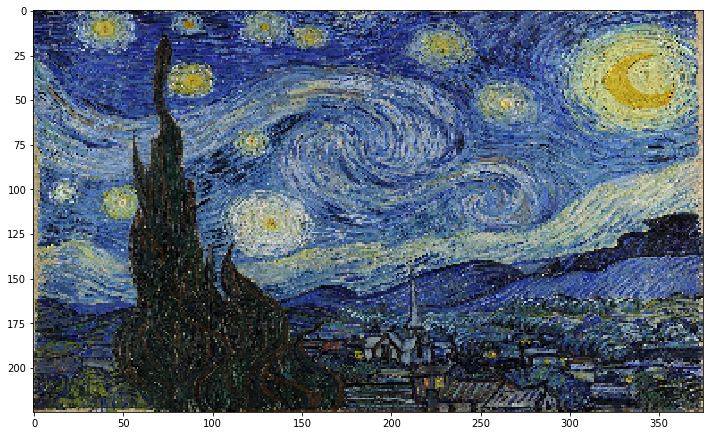

Step 0, loss 0.6168045401573181


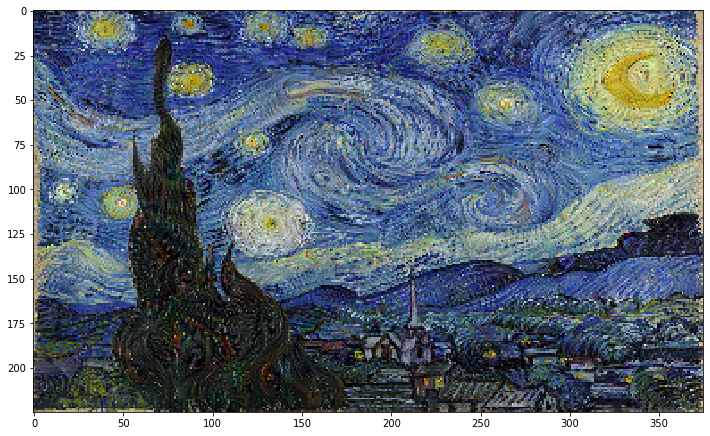

Step 100, loss 1.4085623025894165


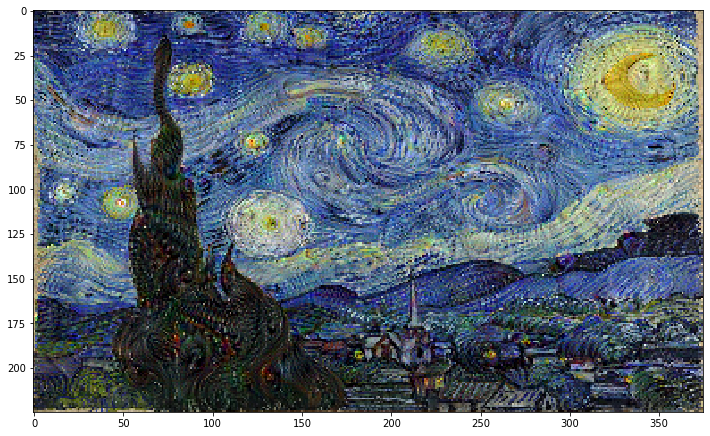

Step 200, loss 1.7199418544769287


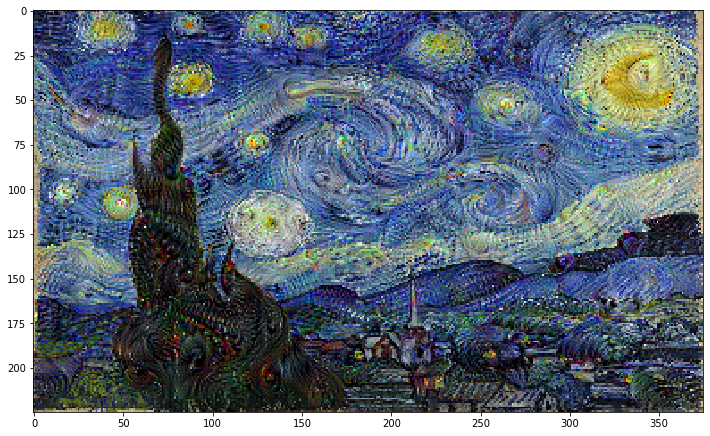

Step 300, loss 1.9095466136932373


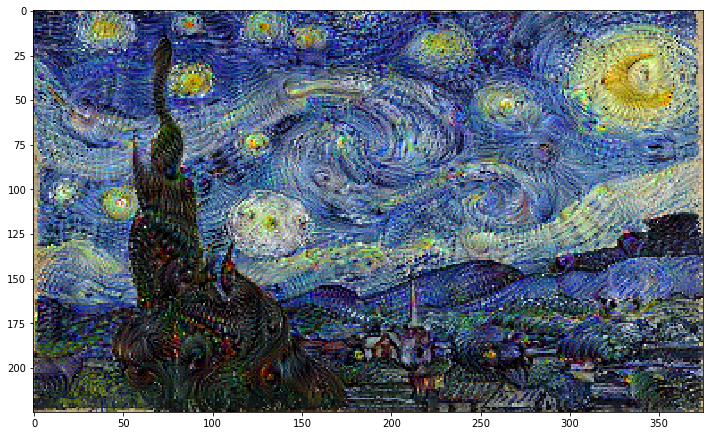

Step 400, loss 2.048961639404297


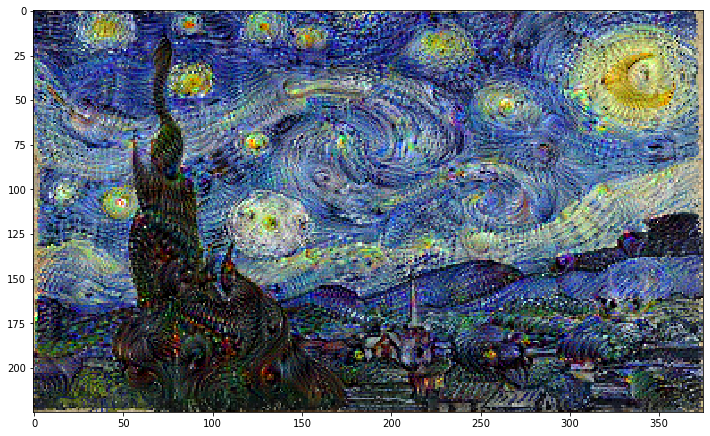

Step 500, loss 2.160834312438965


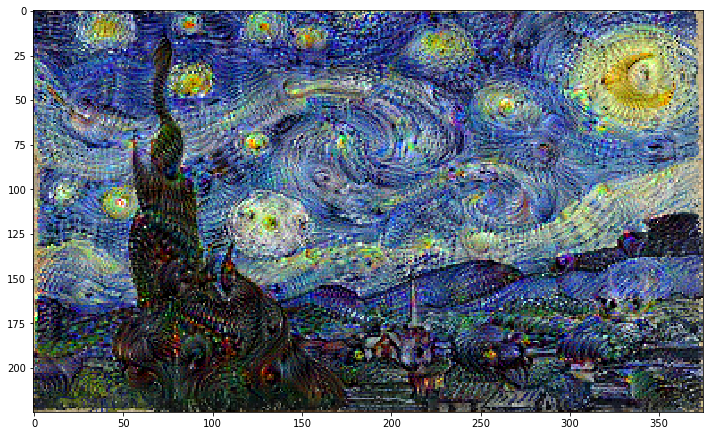

Step 600, loss 2.251117467880249


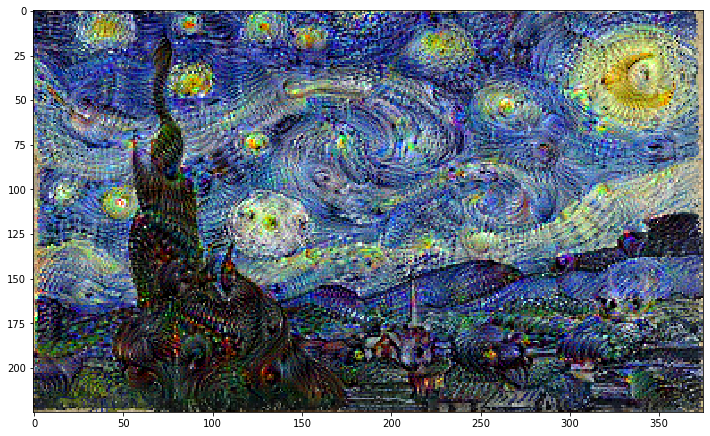

Step 700, loss 2.3309552669525146


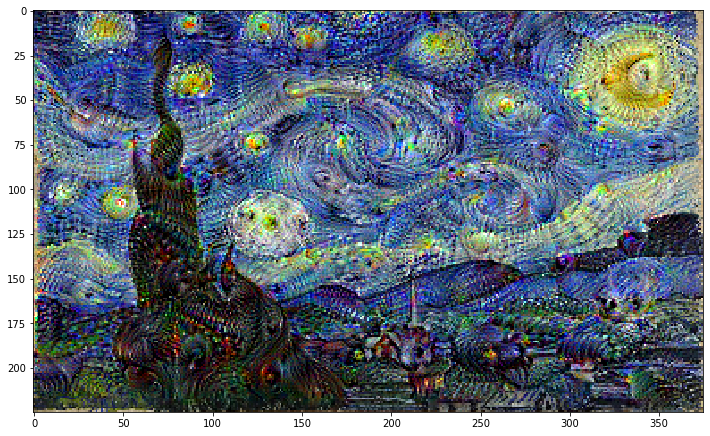

Step 800, loss 2.4025943279266357


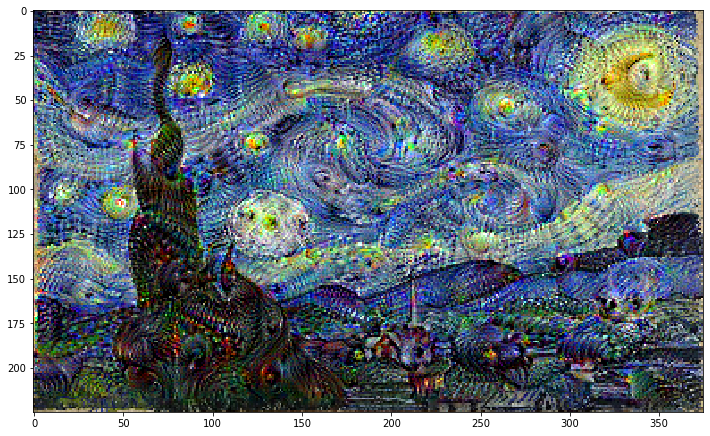

Step 900, loss 2.4693241119384766


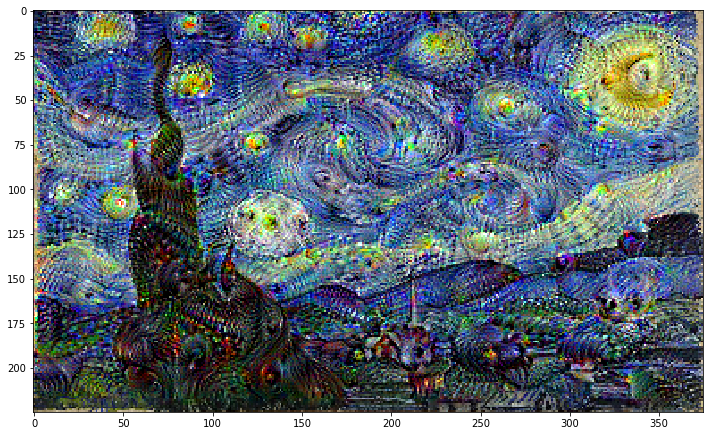

Step 1000, loss 2.532108783721924


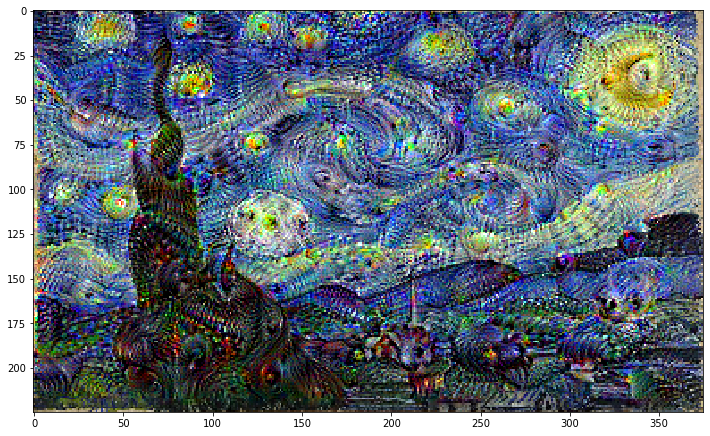

Step 1100, loss 2.5908782482147217


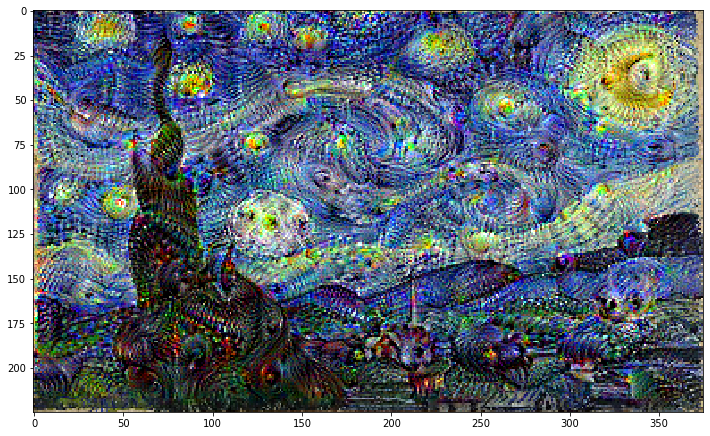

Step 1200, loss 2.6459550857543945


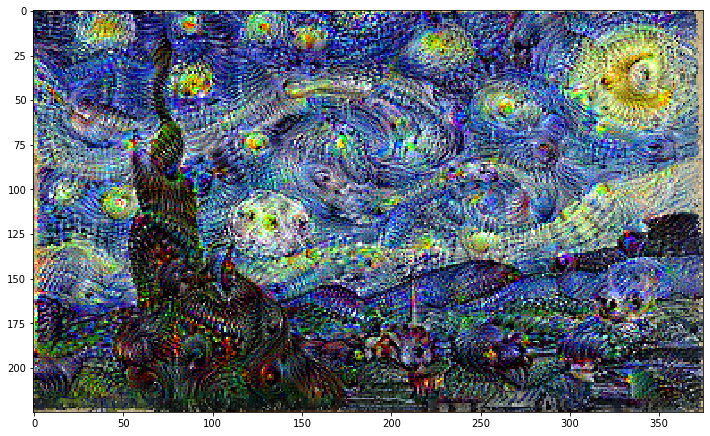

Step 1300, loss 2.6975419521331787


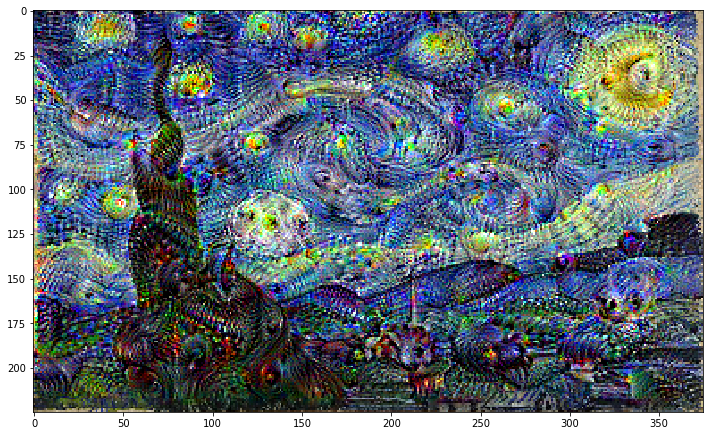

Step 1400, loss 2.746857166290283


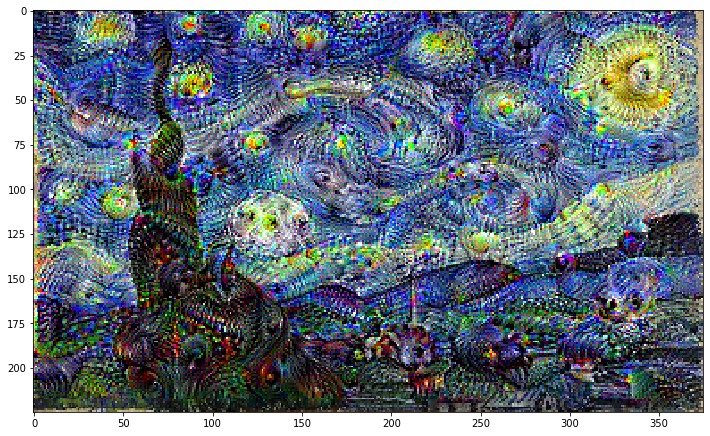

Step 1500, loss 2.794464349746704


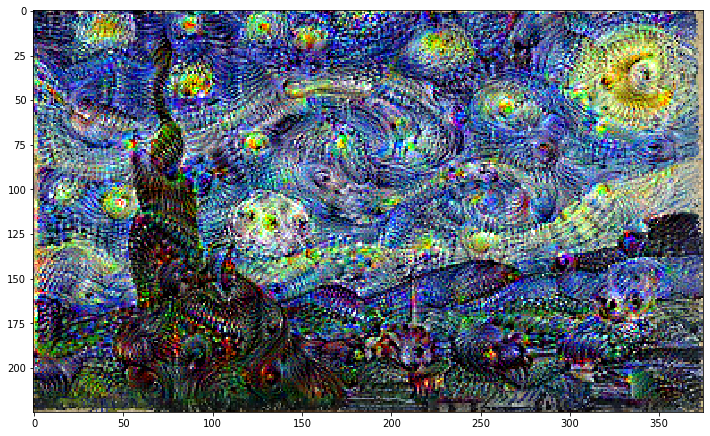

Step 1600, loss 2.838902711868286


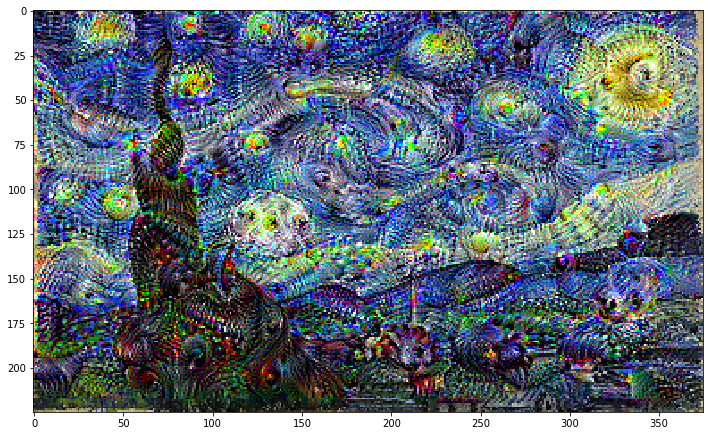

Step 1700, loss 2.880223274230957


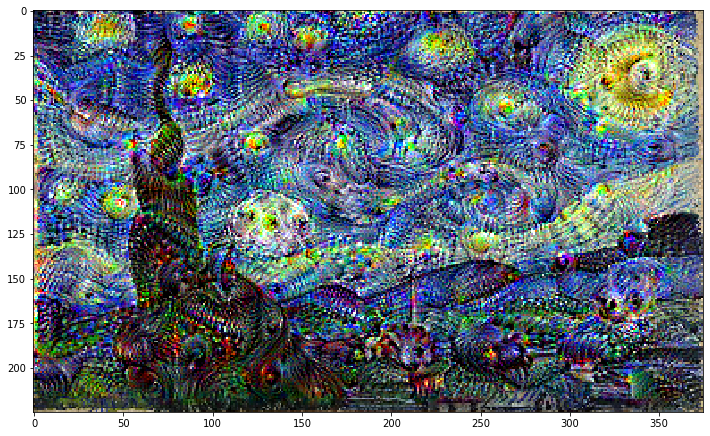

Step 1800, loss 2.919127941131592


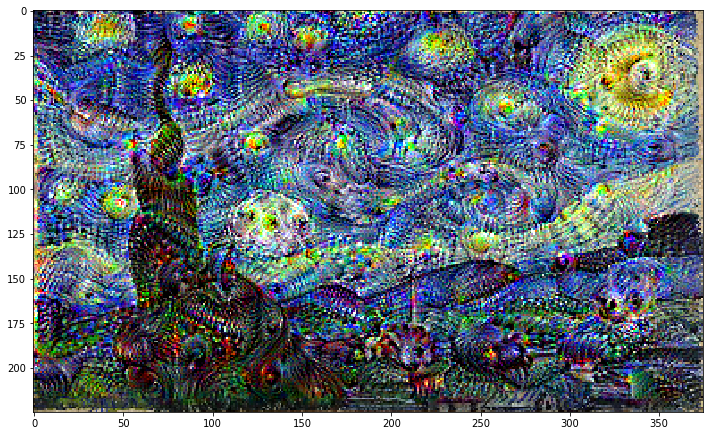

Step 1900, loss 2.9570541381835938


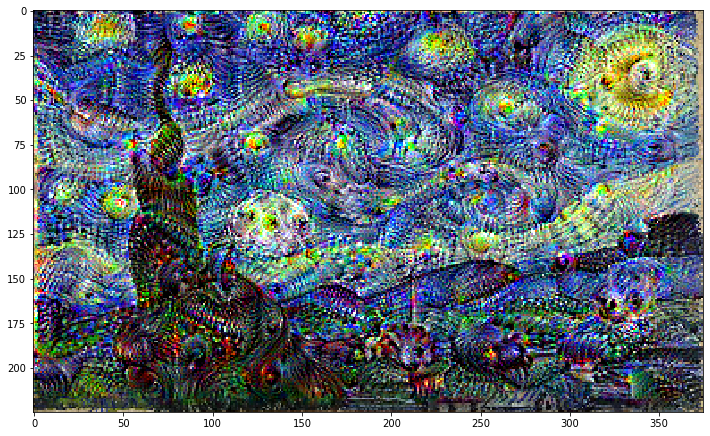

In [ ]:
dream_img = run_deep_dream_simple(model = deepdream_model, 
                                  image = test_image,
                                  steps = 2000, step_size = 0.001)

# Etapa 8: Executando em mais dimensões

In [ ]:
escala = 1.3
test_image2 = tf.keras.preprocessing.image.load_img(r'/content/sky.jpeg',
                                                     target_size = (225, 375))
#test_image2 = np.array(test_image2)
#test_image2 = tf.keras.applications.inception_v3.preprocess_input(test_image2)

image = tf.constant(np.array(test_image2))
base_shape = tf.cast(tf.shape(image)[:-1], tf.float32)

In [ ]:
type(image)

tensorflow.python.framework.ops.EagerTensor

In [ ]:
np.shape(image)

TensorShape([225, 375, 3])

In [ ]:
type(base_shape)

tensorflow.python.framework.ops.EagerTensor

In [ ]:
np.shape(base_shape)

TensorShape([2])

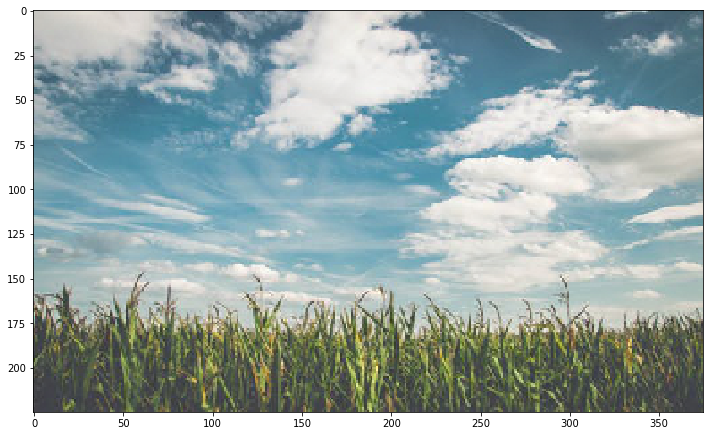

Step 0, loss 0.6144235134124756


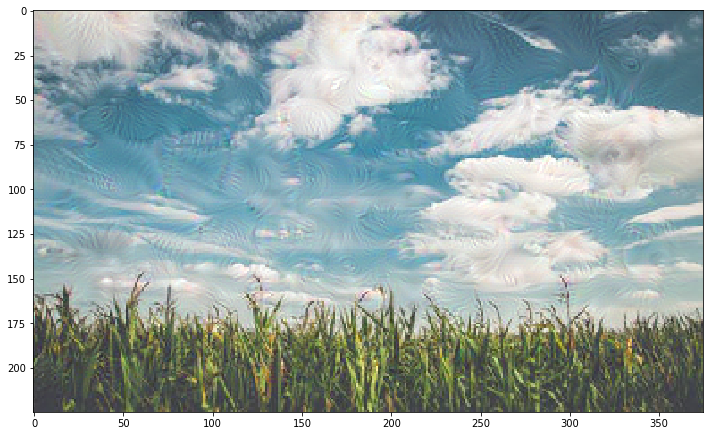

Step 100, loss 1.382552146911621


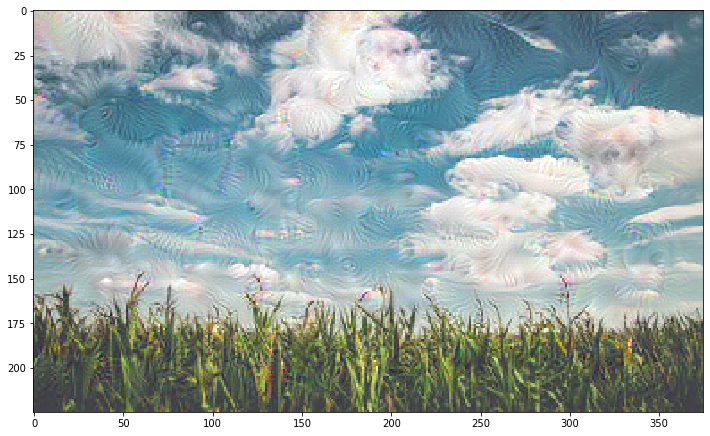

Step 200, loss 1.6323556900024414


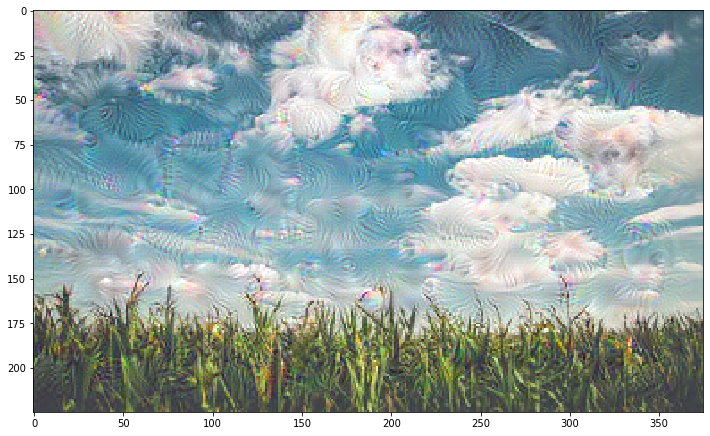

Step 300, loss 1.7853991985321045


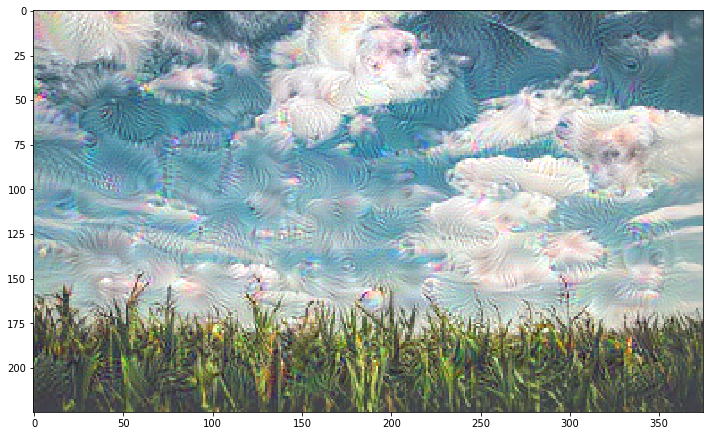

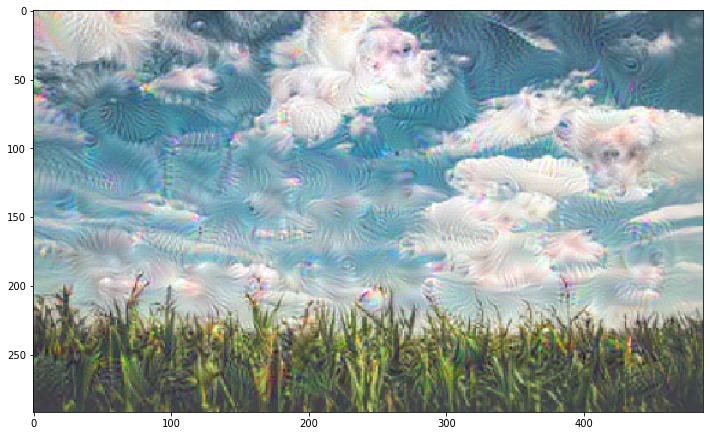

Step 0, loss 0.9043289422988892


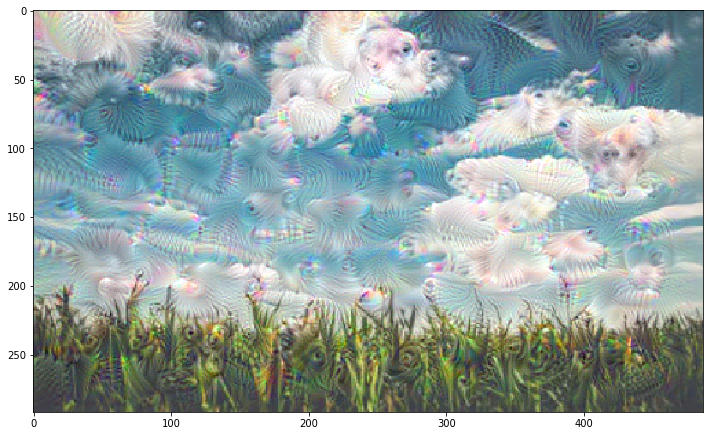

Step 100, loss 1.6209218502044678


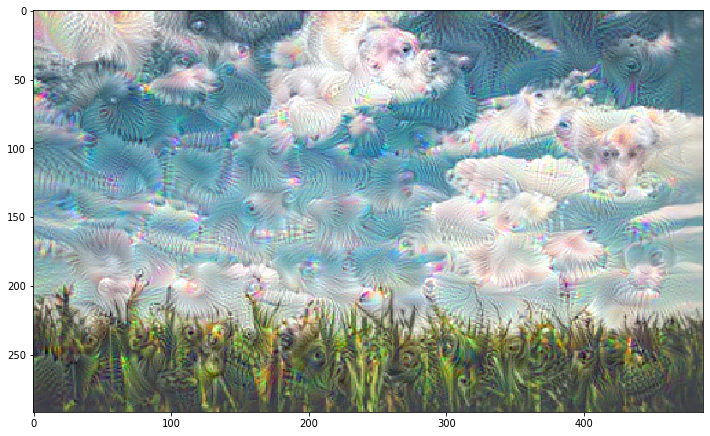

Step 200, loss 1.8115122318267822


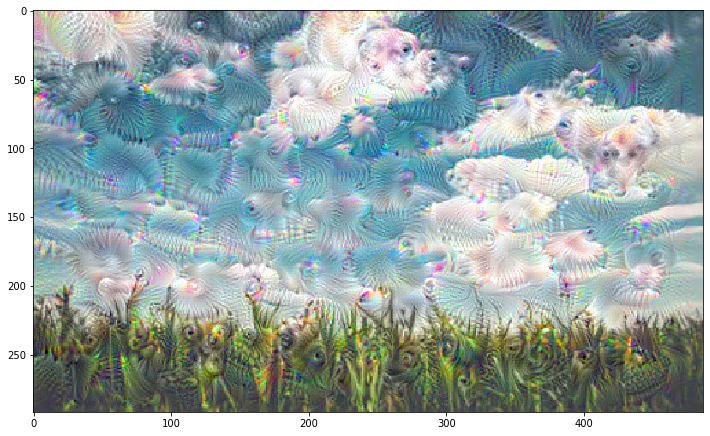

Step 300, loss 1.932361364364624


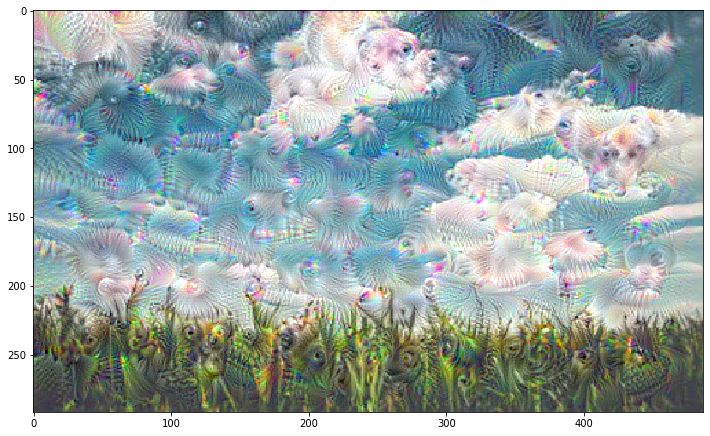

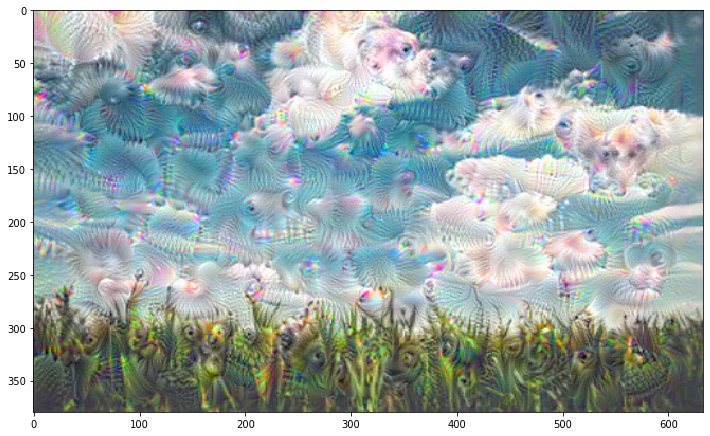

Step 0, loss 0.9292911291122437


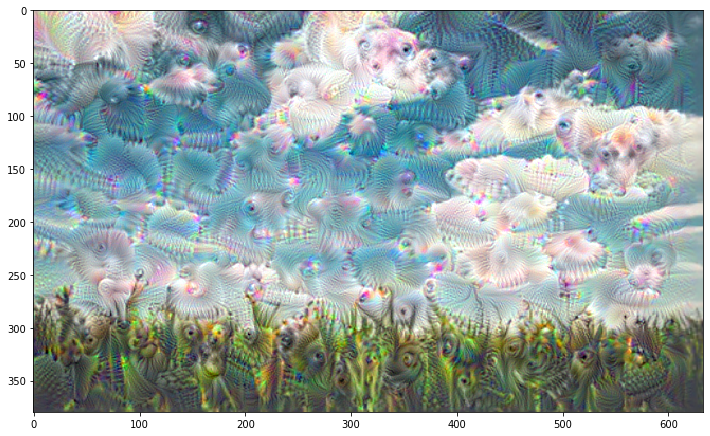

Step 100, loss 1.659644365310669


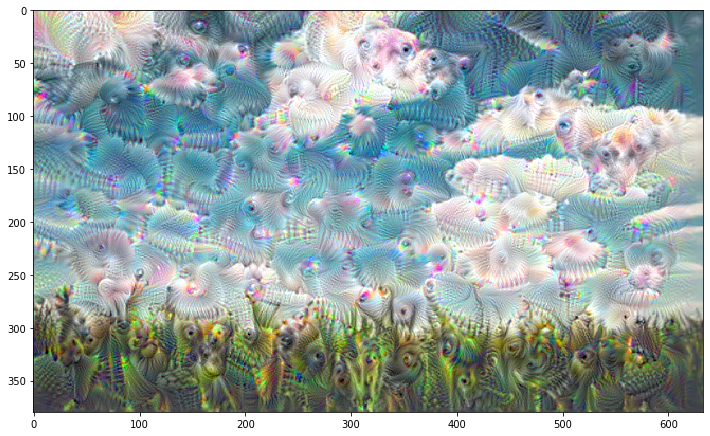

Step 200, loss 1.8601644039154053


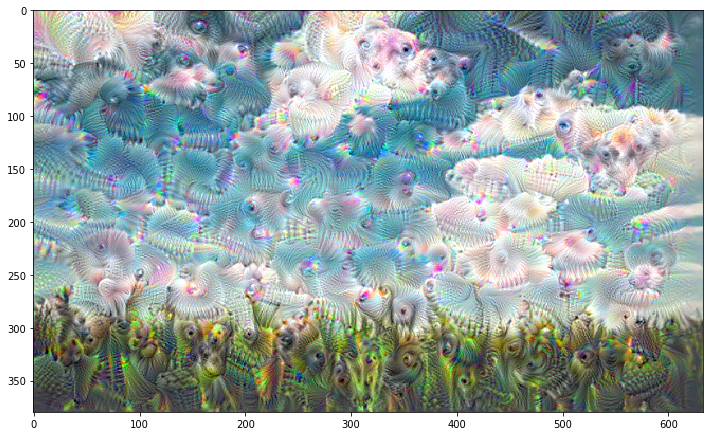

Step 300, loss 1.9843448400497437


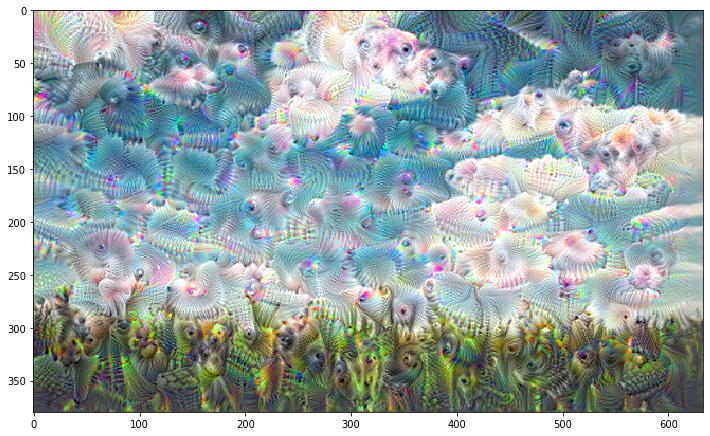

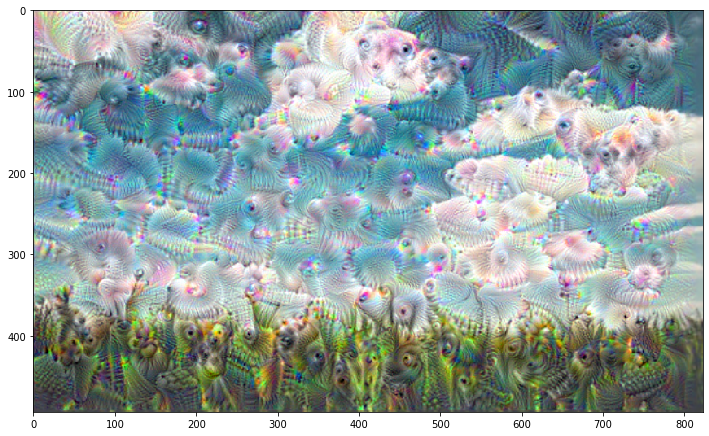

Step 0, loss 0.9358922243118286


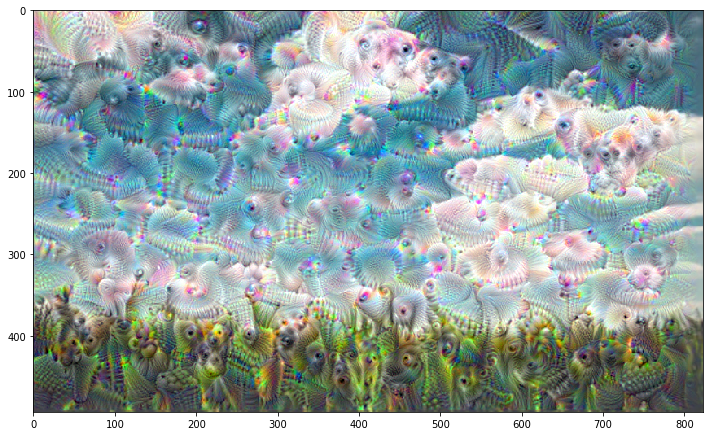

Step 100, loss 1.6679493188858032


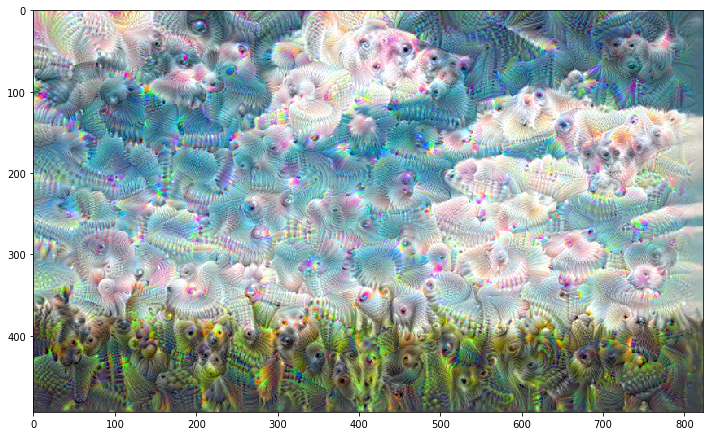

Step 200, loss 1.8674137592315674


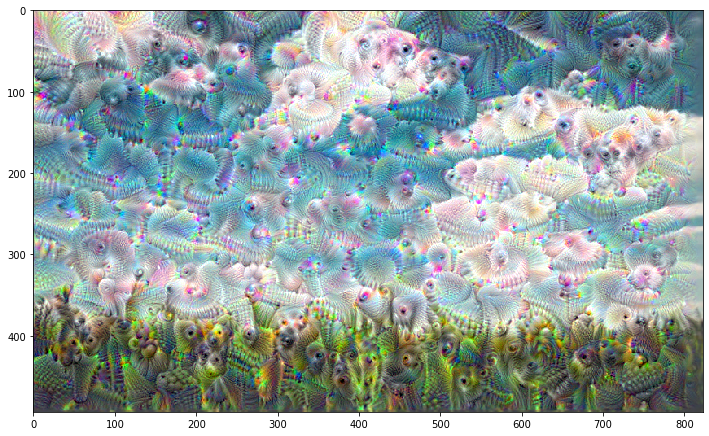

Step 300, loss 1.991328477859497


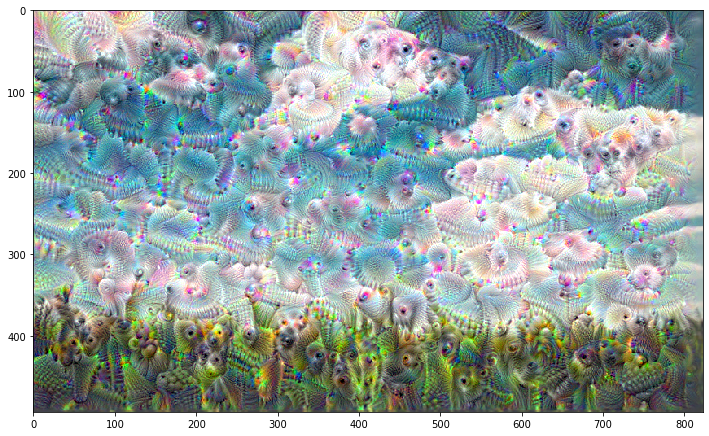

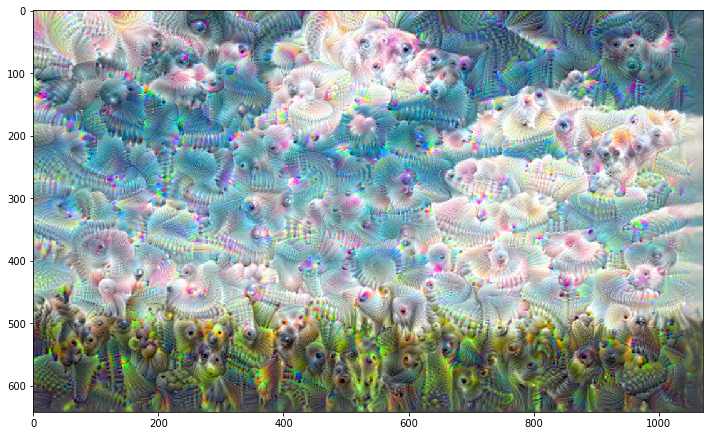

Step 0, loss 0.9304786920547485


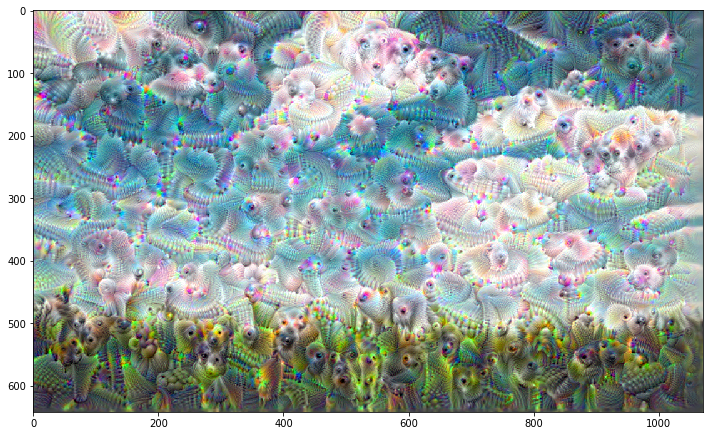

Step 100, loss 1.6707385778427124


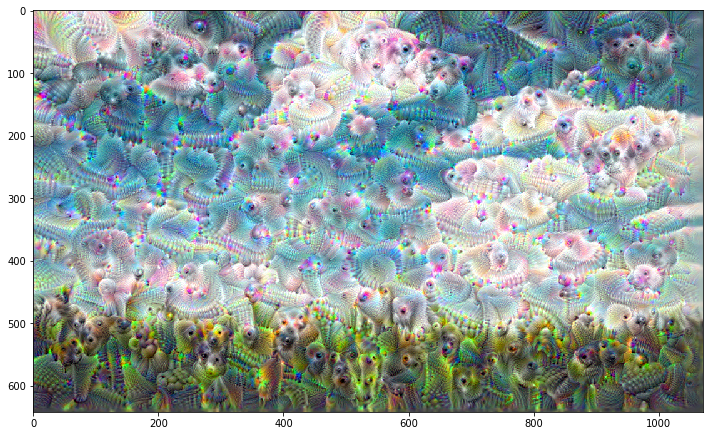

Step 200, loss 1.8757086992263794


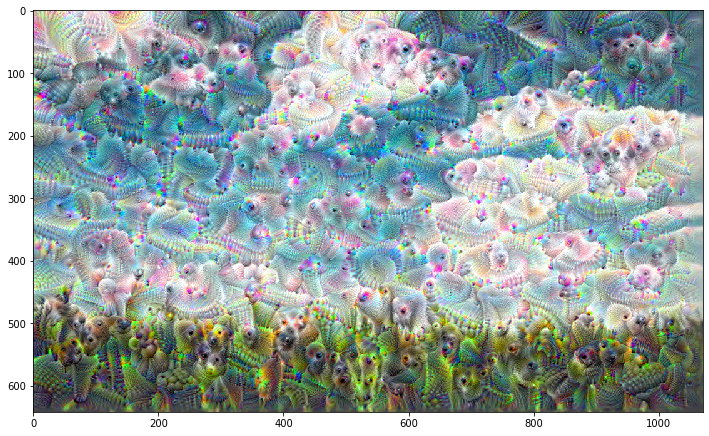

Step 300, loss 2.001789093017578


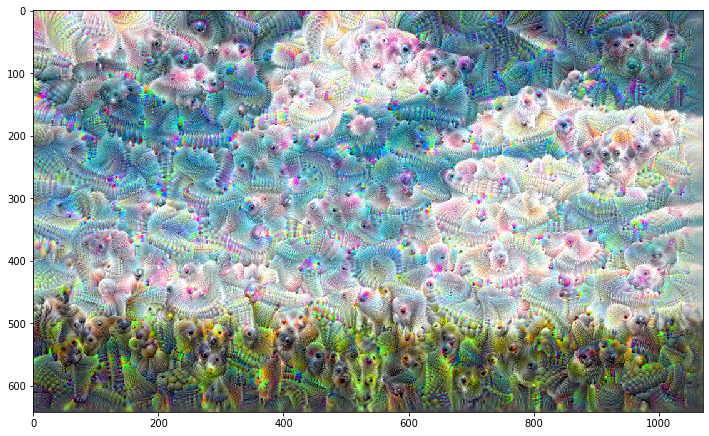

In [ ]:
for n in range(5):
  new_shape = tf.cast(base_shape * (escala**n), tf.int32)
  image = tf.image.resize(image, new_shape).numpy()
  image = run_deep_dream_simple(model=deepdream_model,image = image,
                                steps = 400, step_size = 0.001)